# Set ROIs

This notebook allows you to make ROIs for a video without going through the entire pipeline. The example frame used as the image to set the ROIs is fetched using OpenCV's video reader.\
The functionality of this notebook is technically subsumed by the basic pipeline notebook.

**If your data is local**: Just specify the path to the video you want to draw ROIs on.

**If your data is on a server**: OpenCV's video reader allows for you to read just a single frame from a video file without transferring the entire thing IF the server directory is mounted. So we recommend mounting the server directory if possible to avoid transferring the entire file. This can be done with:
- Windows: https://support.microsoft.com/en-us/windows/map-a-network-drive-in-windows-29ce55d1-34e3-a7e2-4801-131475f9557d
- OSX: https://www.google.com/search?q=mount+network+drive+osx
- Linux: Use RClone CLI: `rclone mount remote:path/to/files /path/to/local/mount`
    - Example: `rclone mount transfer:/n/files/Neurobio/MICROSCOPE/ /mnt/MICROSCOPE/`
    

In [1]:
# ALWAYS RUN THIS CELL
# widen jupyter notebook window
from IPython.display import display, HTML
display(HTML("<style>.container {width:95% !important; }</style>"))

%load_ext autoreload
%autoreload 2
import face_rhythm as fr

from pprint import pprint
from pathlib import Path
import copy

import cv2

import numpy as np
import torch
import matplotlib.pyplot
from tqdm import tqdm
import natsort

fr.util.system_info(verbose=True);

2025-03-12 11:25:03.445 python[10248:1356527] +[IMKClient subclass]: chose IMKClient_Modern
2025-03-12 11:25:03.445 python[10248:1356527] +[IMKInputSession subclass]: chose IMKInputSession_Modern


== Operating System ==: uname_result(system='Darwin', node='Richards-MacBook-Air-2.local', release='24.3.0', version='Darwin Kernel Version 24.3.0: Thu Jan  2 20:23:36 PST 2025; root:xnu-11215.81.4~3/RELEASE_ARM64_T8112', machine='arm64')
== CPU Info ==: Error: Failed to get
== RAM ==: svmem(total=25769803776, available=11850547200, percent=54.0, used=12241715200, free=1739112448, active=10126557184, inactive=7347355648, wired=2115158016)
== GPU Info ==: {}
== Conda Environment ==: fr
== Python Version ==: 3.11.11
== GCC Version ==: (clang-1600.0.26.6)
== PyTorch Version ==: 2.6.0
== CUDA is not available ==
== face_rhythm Version ==: <module 'face_rhythm' from '/Users/richardhakim/Documents/github_repos/face-rhythm/face_rhythm/__init__.py'>
== face_rhythm date installed ==: Sat Mar  8 16:52:30 2025


/Users/richardhakim/Documents/github_repos/face-rhythm/face_rhythm/util.py:978: UserWarning: RH WARNING: unable to get cpu info. Got error: [Errno 13] Permission denied
  warnings.warn(f'RH WARNING: unable to get cpu info. Got error: {e}')


## Set paths

In [2]:
use_remote = True  ## set to True if running on remote machine. Will use SFTP to find files and load frames

In [3]:
# directory_videos  = '/mnt/MICROSCOPE/Gyu/BMI_data/cage_0403/mouse_0403L/'
directory_videos  = '/n/files/Neurobio/MICROSCOPE/Rich/data/2pRAM/facerhythm_stroke_biomarker_exp/camera/'
filename_strMatch = 'video1.*avi'  ## You can use regular expressions to search and match more complex strings


In [5]:
if use_remote:
    import bnpm
    import getpass
    use_localSshKey = False
    path_sshKey = '/home/rich/.ssh/id_rsa' if use_localSshKey else None
    
    ssh_t = bnpm.server.ssh_interface(
        nbytes_toReceive=20000,
        recv_timeout=1,
        verbose=True,
    )
    ssh_t.o2_connect(
        hostname='transfer.rc.hms.harvard.edu',
        username=input('Username: '),
        password=getpass.getpass(prompt='Password: ') if (use_localSshKey==False) else None,
        key_filename=path_sshKey,
        look_for_keys=False,
        passcode_method=1,
        verbose=0,
        skip_passcode=False,    
    )
    # ssh_t.fasrc_connect(
    #     hostname='login.rc.fas.harvard.edu',
    #     username=input('Username: '),
    #     password=getpass.getpass(prompt='Password: ') if (use_localSshKey==False) else None,
    #     verbose=0,
    # )
    sftp_t = bnpm.server.sftp_interface(ssh_client=ssh_t.client)

INFO:paramiko.transport:Connected (version 2.0, client OpenSSH_7.4)
INFO:paramiko.transport:Auth banner: b'Problems logging in?\nUse your lower case HMS ID, like abc123, not ABC123.\nIf locked out, see:\nhttps://it.hms.harvard.edu/i-want/reset-password-or-unlock-your-hms-account\n'
INFO:paramiko.transport:Authentication (password) successful!
INFO:paramiko.transport.sftp:[chan 1] Opened sftp connection (server version 3)


In [6]:
if use_remote:
    paths_videos = sftp_t.search_recursive(
        dir_outer='/n/files/Neurobio/MICROSCOPE/Rich/data/2pRAM/facerhythm_stroke_biomarker_exp/camera/', 
        reMatch='video1.*avi', 
        reMatch_in_path='PS47',
        depth=5,
        find_files=True,
        find_folders=True,
        natsorted=True,
        verbose=True
    )
else:
    paths_videos = fr.helpers.find_paths(
        dir_outer=directory_videos,
        reMatch=filename_strMatch,  ## string to use to search for files in directory. Uses regular expressions!alg_ns=
        reMatch_in_path='PS47',
        depth=5,  ## how many folders deep to search
        verbose=True,
    )

display(paths_videos)

/n/files/Neurobio/MICROSCOPE/Rich/data/2pRAM/facerhythm_stroke_biomarker_exp/camera/20250301/PS47/video1_2025-03-01T13_22_27.avi
/n/files/Neurobio/MICROSCOPE/Rich/data/2pRAM/facerhythm_stroke_biomarker_exp/camera/20250309/PS47/video1_2025-03-09T06_41_41.avi
/n/files/Neurobio/MICROSCOPE/Rich/data/2pRAM/facerhythm_stroke_biomarker_exp/camera/20250305/PS47/video1_2025-03-05T12_53_03.avi
/n/files/Neurobio/MICROSCOPE/Rich/data/2pRAM/facerhythm_stroke_biomarker_exp/camera/20250225/PS47/video1_2025-02-25T14_00_06.avi
/n/files/Neurobio/MICROSCOPE/Rich/data/2pRAM/facerhythm_stroke_biomarker_exp/camera/20250310/PS47/video1_2025-03-10T13_35_52.avi
/n/files/Neurobio/MICROSCOPE/Rich/data/2pRAM/facerhythm_stroke_biomarker_exp/camera/20250227/PS47/video1_2025-02-27T13_25_37.avi
/n/files/Neurobio/MICROSCOPE/Rich/data/2pRAM/facerhythm_stroke_biomarker_exp/camera/20250303/PS47/video1_2025-03-03T14_13_07.avi
/n/files/Neurobio/MICROSCOPE/Rich/data/2pRAM/facerhythm_stroke_biomarker_exp/camera/20250306/PS47

['/n/files/Neurobio/MICROSCOPE/Rich/data/2pRAM/facerhythm_stroke_biomarker_exp/camera/20250225/PS47/video1_2025-02-25T14_00_06.avi',
 '/n/files/Neurobio/MICROSCOPE/Rich/data/2pRAM/facerhythm_stroke_biomarker_exp/camera/20250227/PS47/video1_2025-02-27T13_25_37.avi',
 '/n/files/Neurobio/MICROSCOPE/Rich/data/2pRAM/facerhythm_stroke_biomarker_exp/camera/20250228/PS47/video1_2025-02-28T12_16_17.avi',
 '/n/files/Neurobio/MICROSCOPE/Rich/data/2pRAM/facerhythm_stroke_biomarker_exp/camera/20250301/PS47/video1_2025-03-01T13_22_27.avi',
 '/n/files/Neurobio/MICROSCOPE/Rich/data/2pRAM/facerhythm_stroke_biomarker_exp/camera/20250303/PS47/video1_2025-03-03T14_13_07.avi',
 '/n/files/Neurobio/MICROSCOPE/Rich/data/2pRAM/facerhythm_stroke_biomarker_exp/camera/20250304/PS47/video1_2025-03-04T18_19_46.avi',
 '/n/files/Neurobio/MICROSCOPE/Rich/data/2pRAM/facerhythm_stroke_biomarker_exp/camera/20250305/PS47/video1_2025-03-05T12_53_03.avi',
 '/n/files/Neurobio/MICROSCOPE/Rich/data/2pRAM/facerhythm_stroke_biom

In [7]:
names_sessions = natsort.natsorted([bnpm.path_helpers.find_date_in_path(p).replace('-', '') for p in paths_videos])
names_sessions

['20250225',
 '20250227',
 '20250228',
 '20250301',
 '20250303',
 '20250304',
 '20250305',
 '20250306',
 '20250307',
 '20250308',
 '20250309',
 '20250310',
 '20250311']

In [8]:
directory_save = r'/Users/richardhakim/Documents/data/aligned_dots/'

## Fetch image

In [9]:
# idx_template = 5

In [10]:
# path_vid_template = paths_videos[idx_template]
# path_vid_template

#### Using a remote server
- (if your videos are on the local computer, then skip past this step)
- Make sure ffmpeg is installed if you want to import first frames from a remote server. It is not necessary otherwise

In [11]:
if use_remote:
    
    import base64
    import ffmpeg
    from PIL import Image
    import io
    import numpy as np
    import os

    class SFTPVideoFrameExtractor:
        """
        A class to extract the first frame from remote video files via SFTP and return it as a NumPy array.
        
        The password is stored in an encoded form and only decoded when constructing the SFTP URL.
        The extraction leverages ffmpeg to stream just the required data.
        
        RH 2023
        
        Args:
            host (str):
                The hostname or IP address of the remote server.
            username (str):
                The username to authenticate with the remote server.
            password (str):
                The password to authenticate with the remote server.
            port (int, optional):
                The port to use for SFTP. Defaults to 22.
        """
        
        def __init__(self, host: str, username: str, password: str, port: int = 22) -> None:
            # Encode the password in base64 for secure internal storage.
            self.host = host
            self.username = username
            self.port = port
            # encode password
            self._salt = os.urandom(32)
            self._encoded_password = base64.b64encode(self._salt + password.encode())
        
        def _decode_password(self) -> str:
            """
            Decodes the stored password from its encoded form.
            
            Returns:
                str:
                    The decoded password.
            """
            return base64.b64decode(self._encoded_password)[32:].decode()
        
        def extract_frames(self, remote_video_path: str, time_start: float, num_frames: int) -> np.ndarray:
            """
            Extracts the first frame from a video file located on a remote server via SFTP,
            and returns it as a NumPy array.
            
            Args:
                remote_video_path (str):
                    The path to the video file on the remote server, e.g. "/path/to/video.mp4".
                    
            Returns:
                np.ndarray:
                    The first frame of the video as a NumPy array.
                    
            Raises:
                RuntimeError: If ffmpeg fails to extract the frame.
            """
            # Decode password for constructing the SFTP URL.
            password = self._decode_password()
            
            # Construct the SFTP URL. Include the port only if it is not the default 22.
            if self.port == 22:
                sftp_url = f"sftp://{self.username}:{password}@{self.host}{remote_video_path}"
            else:
                sftp_url = f"sftp://{self.username}:{password}@{self.host}:{self.port}{remote_video_path}"
                    
            try:
                # Use ffmpeg with a select filter to output multiple frames as PNG images.
                # Replace the ffmpeg output command with this version that explicitly forces lossless PNG output:
                out, err = (
                    ffmpeg
                    .input(sftp_url, ss=time_start)
                    .output(
                        "pipe:",
                        format="image2pipe",
                        vcodec="png",
                        vframes=num_frames,
                        pix_fmt="rgb24",  # Force full color lossless output.
                        vsync=0
                    ).run(capture_stdout=True, capture_stderr=True)
                )
            except ffmpeg.Error as e:
                raise RuntimeError(f"Error extracting frames: {e.stderr.decode()}") from e

            # Helper function to split concatenated PNG images from the pipe.
            def split_pngs(data: bytes) -> list:
                signature = b'\x89PNG\r\n\x1a\n'
                images = []
                start = data.find(signature)
                while start != -1:
                    next_start = data.find(signature, start + 1)
                    if next_start == -1:
                        images.append(data[start:])
                        break
                    else:
                        images.append(data[start:next_start])
                        start = next_start
                return images

            png_data_list = split_pngs(out)
            frames = []
            for png_data in png_data_list:
                img = Image.open(io.BytesIO(png_data))
                frames.append(np.array(img))
            return np.array(frames)

In [12]:
if use_remote:
    # Replace with your actual connection details and remote video path.
    extractor = SFTPVideoFrameExtractor(
        host="transfer.rc.hms.harvard.edu",
        username=input("Enter your username: "),
        password=getpass.getpass(prompt="Enter your password: "),
        port=22,  # or your specific port
    )

In [13]:
# if use_remote:
#     # Specify the path to the remote video file.
#     im_test = np.array(extractor.extract_frames(path_vid_template, 0, 250*20), dtype=np.float32).mean(-1)
# else:
#     vc = cv2.VideoCapture(paths_videos[5])
#     s, im_test = vc.read()
#     im_test = im_test.astype(np.float32).mean(-1)


In [14]:
# bnpm.misc.estimate_array_size(im_test)

In [15]:
import matplotlib.pyplot as plt
from typing import List, Optional, Dict

In [16]:
class Image_preparation_pipeline():
    def __init__(
        self,
        ds_factor: int = 20,
        
        ptile_specVar_keep: float = 10,
        ptile_intensity_keep: float = 90,
        params_vqt: Dict = {
            "Fs_sample": 250,
            "Q_lowF": 3.5,
            "Q_highF": 20,
            "F_min": 0.5,
            "F_max": 60,
            "n_freq_bins": 50,
            "window_type": 'hann',
            "downsample_factor": 10,
            "fft_conv": True,
            "plot_pref": False,
        },
        
        clip_limit: float = 2.0,
        grid_size: int = 20,
        
        verbose: bool = True,
    ) -> None:
        self.ds_factor = ds_factor
        self.ptile_specVar_keep = ptile_specVar_keep
        self.ptile_intensity_keep = ptile_intensity_keep
        self.params_vqt = params_vqt
        self.clip_limit = clip_limit
        self.grid_size = grid_size
        self.verbose = verbose

    def downsample(self, images: np.ndarray, ds_factor: Optional[int]=None) -> np.ndarray:
        import torch
        images_tensor = torch.as_tensor(images, dtype=torch.float32)
        images_tensor = images_tensor.mean(-1) if images_tensor.ndim == 4 else images_tensor
        ds_factor = self.ds_factor if ds_factor is None else ds_factor
        images_ds = torch.nn.functional.interpolate(images_tensor.permute(0, 1, 2)[None, ...], size=(images_tensor.shape[1]//ds_factor, images_tensor.shape[2]//ds_factor), mode='bilinear', align_corners=False).float().numpy()[0]
        
        if self.verbose:
            print(f"Images shape: {images.shape}")
            print(f"Images downsampled shape: {images_ds.shape}")
            plt.figure()
            plt.imshow(images_ds[0])
        return images_ds
    
    def find_low_spectral_variance_idx(
        self,
        images_ds: np.ndarray,
        images: np.ndarray,
        ptile_specVar_keep: Optional[float] = 10,
        ptile_intensity_keep: Optional[float] = 90,
        params_vqt: Optional[Dict] = {
            "Fs_sample": 250,
            "Q_lowF": 3.5,
            "Q_highF": 20,
            "F_min": 0.5,
            "F_max": 60,
            "n_freq_bins": 50,
            "window_type": 'hann',
            "downsample_factor": 10,
            "fft_conv": True,
            "plot_pref": False,
        },
    ):
        import vqt
        import torch
        
        ptile_specVar_keep = self.ptile_specVar_keep if ptile_specVar_keep is None else ptile_specVar_keep
        ptile_intensity_keep = self.ptile_intensity_keep if ptile_intensity_keep is None else ptile_intensity_keep
        params_vqt = self.params_vqt if params_vqt is None else params_vqt
        
        my_vqt = vqt.VQT(**params_vqt)

        spec = my_vqt.forward(torch.as_tensor(images_ds, dtype=torch.float32).reshape(images_ds.shape[0], -1).T)
        spec = spec.permute(1, 2, 0).reshape(spec.shape[1], spec.shape[2], images_ds.shape[1], images_ds.shape[2])
        xAxis = my_vqt.get_xAxis(n_samples=images_ds.shape[0])
        
        if self.verbose:
            ## plot a random spectrogram
            plt.figure()
            plt.imshow(spec[:, :, np.random.randint(0, spec.shape[-2]), np.random.randint(0, spec.shape[-1])], aspect='auto')
        
        vals = spec.numpy().mean((0, 2, 3))
        idx = np.int64(xAxis[np.where(vals < np.percentile(vals, ptile_specVar_keep))[0]])

        images = images.mean(-1) if images.ndim == 4 else images
        # v = images[idx].astype(np.float32).var(0)
        # v = np.clip(v, 1e-1, np.percentile(v, ptile_intensity_keep))
        im = images[idx].mean(0)
        # im /= v
        # im = np.nan_to_num(im, 0)
        # im = np.clip(im, 0, np.percentile(im, 90))
        im = im ** 0.5
        im /= im.max()
        
        if self.verbose:
            plt.figure()
            plt.imshow(im)
            
        return im
    
    def apply_clahe(
        self,
        image: np.ndarray,
        clip_limit: Optional[float] = 2.0,
        grid_size: Optional[int] = 20,
    ) -> np.ndarray:
        import functools
        
        clip_limit = self.clip_limit if clip_limit is None else clip_limit
        grid_size = self.grid_size if grid_size is None else grid_size

        aligner = fr.rois.Image_Aligner(verbose=self.verbose)

        augmenter = functools.partial(
            aligner.augment_images,
            use_CLAHE=True,
            CLAHE_grid_size=grid_size,
            CLAHE_clipLimit=clip_limit,
            CLAHE_normalize=True,
        )

        im_aug = augmenter(ims=[image])[0]

        if self.verbose:
            plt.figure()
            plt.imshow(im_aug)
            
        return im_aug
    
    def apply_pipeline(
        self,
        images: np.ndarray,
    ):
        images_ds = self.downsample(images)
        im = self.find_low_spectral_variance_idx(images_ds, images)
        im_aug = self.apply_clahe(im)
        
        return im_aug

In [17]:
pipeline = Image_preparation_pipeline(
    ds_factor=20,
    ptile_specVar_keep=10,
    ptile_intensity_keep=100,
    params_vqt={
        "Fs_sample": 250,
        "Q_lowF": 3.5,
        "Q_highF": 20,
        "F_min": 0.5,
        "F_max": 60,
        "n_freq_bins": 50,
        "window_type": 'hann',
        "downsample_factor": 10,
        "fft_conv": True,
        "plot_pref": False,
    },
    clip_limit=2.0,
    grid_size=60,
    verbose=True,
)

In [18]:

# im_aug = pipeline.apply_pipeline(im_test.copy())
# im_aug.shape

In [19]:
# bnpm.video.play_video_pygame(im_test, 250)

# Define ROIs

Either select new ROIs (`select_mode='gui'`), or import existing ROIs (`path_file=path_to_ROIs.h5_file`).\
Typically, you should make 1 or 2 ROIs. One for defining where the face points should be and one for cropping the frame.

In [20]:
# %matplotlib notebook
rois = fr.rois.ROIs(
#     select_mode='gui',
#     exampleImage=image,
    select_mode='file',
    path_file=r'/Users/richardhakim/Documents/data/test_fr_run_20250304_mousePS46_date20250303_cam1/analysis_files/ROIs.h5',
    verbose=2
)

Save the `ROIs` object in the 'analysis_files' project folder

FR: Making points to track
FR: 1861 points total


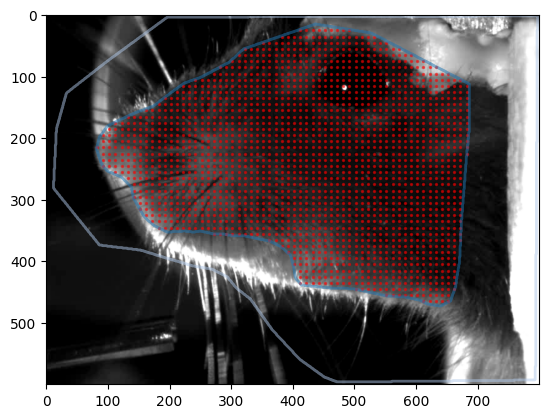

(<Figure size 640x480 with 1 Axes>, <Axes: >)

In [21]:
rois.make_points(rois[0], point_spacing=10)
rois.plot_rois()

In [22]:
# path_save = str(Path(directory_save) / 'ROIs.h5')
# rois.save_run_data(path_run_data=path_save, overwrite=True, verbose=1)

# Optional: Multisession alignment

The below code shows how to align the points from one 'template' session onto multiple other 'new' sessions.\
Steps:
1. Get example images from each session: `images`
2. Optionally adjust the local contrast of each example image to make: `images_toUse`
3. Instantiate the `ROI_Aligner` class and choose which OpenCV optical flow method to use: `aligner`
4. Perform non-rigid registration to warp the 'template' ROIs and points onto the example images from each session: `aligner.align_and_make_ROIs`
5. Retrieve the newly made `ROIs` class objects: `rois_objs_new = aligner.ROIs_objects_new`
6. Save the new `ROIs` class objects: `rois_objs_new[x].save_run_data()`
7. Visualize the results!

1. Get example images

In [23]:
import warnings
from tqdm import tqdm

def get_first_frames(paths, max_attempts=5, verbose=True):
    if isinstance(paths, list) == False:
        paths = [paths]

    def get_first_frame(path, attempt=0):
        frame = cv2.VideoCapture(path).read()[1]
        if frame is None:
            print(f"Received `None` for path: {path}. Attempting again; attempt number: {attempt}")
            if attempt + 1 > max_attempts:
                warnings.warn(f"Failed to get first frame for path:{path}")
                return None
            frame = get_first_frame(path, attempt=attempt+1)
        return frame

    flag_singleOutput = len(paths) == 1
    out = [get_first_frame(path) for path in tqdm(paths, disable=flag_singleOutput)]
    out = out[0] if flag_singleOutput else out
    
    return out
        

  0%|          | 0/13 [00:00<?, ?it/s]

Images shape: (7500, 600, 800)
Images downsampled shape: (7500, 30, 40)


  8%|▊         | 1/13 [05:28<1:05:46, 328.92s/it]

Images shape: (7500, 600, 800)
Images downsampled shape: (7500, 30, 40)


 15%|█▌        | 2/13 [09:23<50:07, 273.37s/it]  

Images shape: (7500, 600, 800)
Images downsampled shape: (7500, 30, 40)


 23%|██▎       | 3/13 [13:09<41:58, 251.85s/it]

Images shape: (7500, 600, 800)
Images downsampled shape: (7500, 30, 40)


 31%|███       | 4/13 [17:11<37:09, 247.74s/it]

Images shape: (7500, 600, 800)
Images downsampled shape: (7500, 30, 40)


 38%|███▊      | 5/13 [21:48<34:28, 258.59s/it]

Images shape: (7500, 600, 800)
Images downsampled shape: (7500, 30, 40)


/var/folders/rj/y1_9lfn16mg3r0j3qg45dxw40000gn/T/ipykernel_10248/1524349161.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()
 46%|████▌     | 6/13 [25:54<29:39, 254.27s/it]

Images shape: (7500, 600, 800)
Images downsampled shape: (7500, 30, 40)


 54%|█████▍    | 7/13 [29:47<24:42, 247.16s/it]

Images shape: (7500, 600, 800)
Images downsampled shape: (7500, 30, 40)


 62%|██████▏   | 8/13 [33:34<20:03, 240.71s/it]

Images shape: (7500, 600, 800)
Images downsampled shape: (7500, 30, 40)


 69%|██████▉   | 9/13 [38:12<16:49, 252.45s/it]

Images shape: (7500, 600, 800)
Images downsampled shape: (7500, 30, 40)


 77%|███████▋  | 10/13 [43:09<13:18, 266.22s/it]

Images shape: (7500, 600, 800)
Images downsampled shape: (7500, 30, 40)


 85%|████████▍ | 11/13 [48:19<09:19, 279.61s/it]

Images shape: (7500, 600, 800)
Images downsampled shape: (7500, 30, 40)


 92%|█████████▏| 12/13 [53:57<04:57, 297.39s/it]

Images shape: (7500, 600, 800)
Images downsampled shape: (7500, 30, 40)


100%|██████████| 13/13 [58:58<00:00, 272.21s/it]


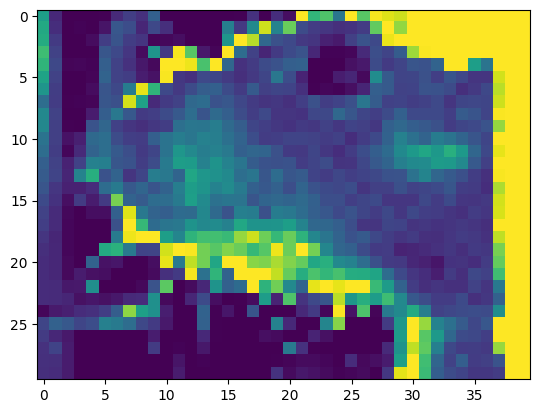

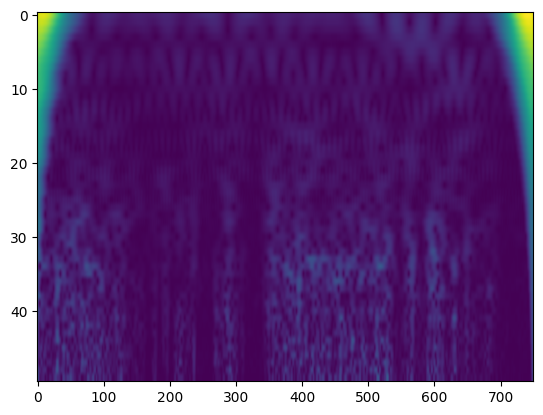

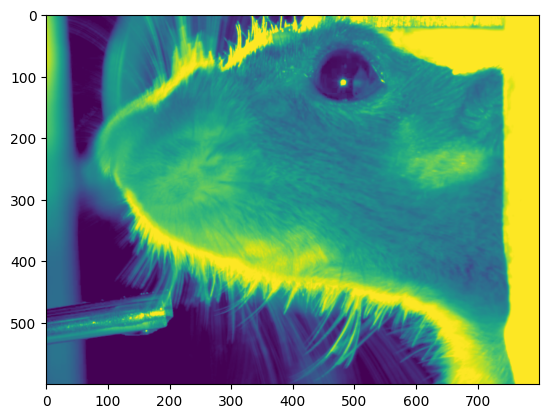

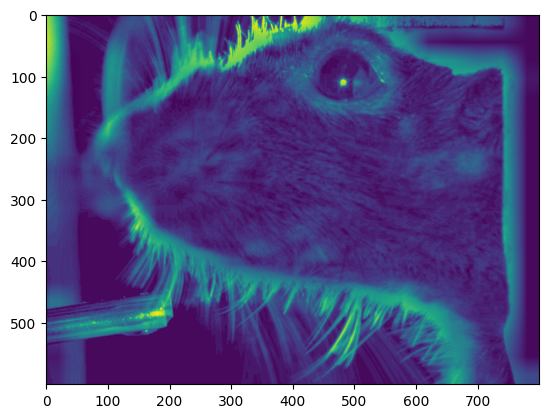

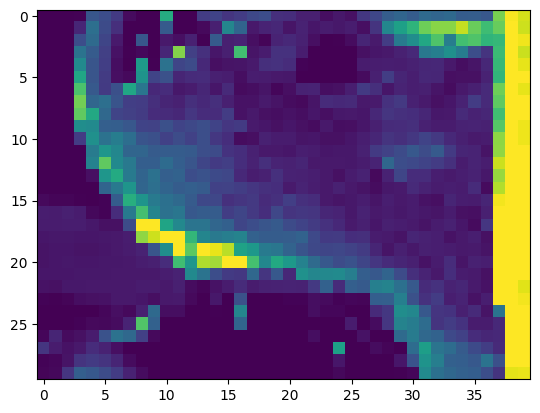

...

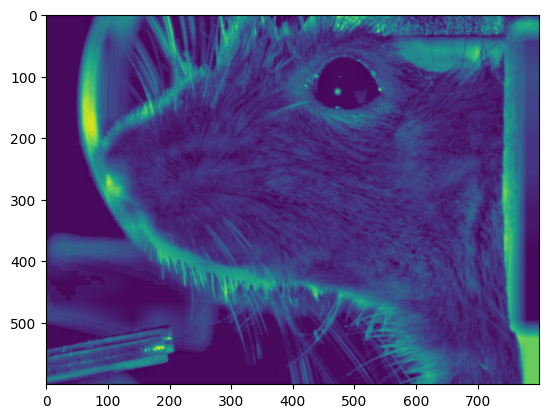

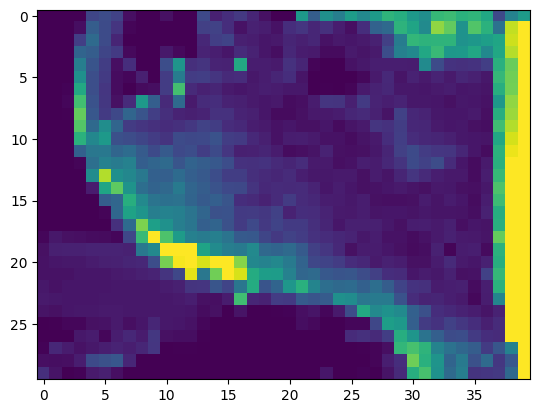

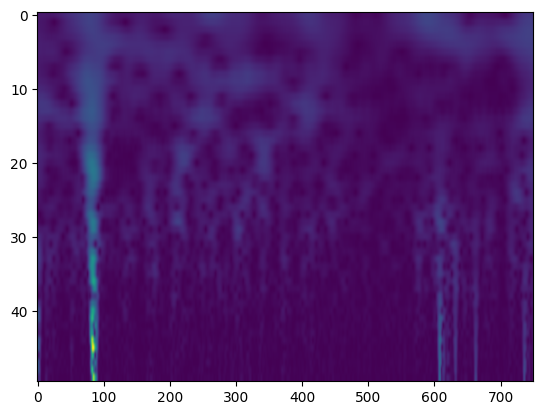

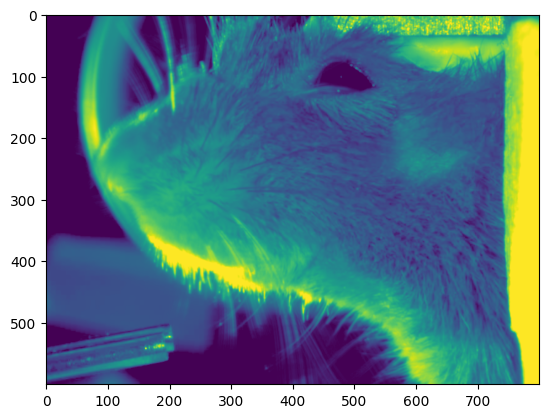

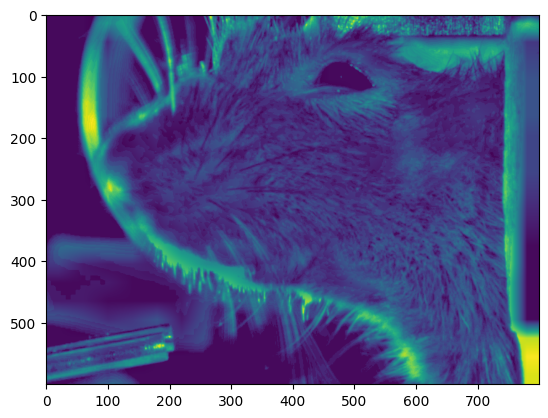

In [24]:
images = {path: pipeline.apply_pipeline(extractor.extract_frames(path, time_start=0, num_frames=250*30).mean(-1)) if use_remote else get_first_frames(path) for path in tqdm(paths_videos)}

2. Optionally adjust local contrast

3. to 5. Register ROIs from template to new session images, then make new `ROIs` objects

In [27]:
ims_aug = list(images.values())

In [30]:
# im_aug_template = ims_aug[idx_template]
im_aug_template = np.load("/Users/richardhakim/Documents/data/aligned_dots/im_template.npy")


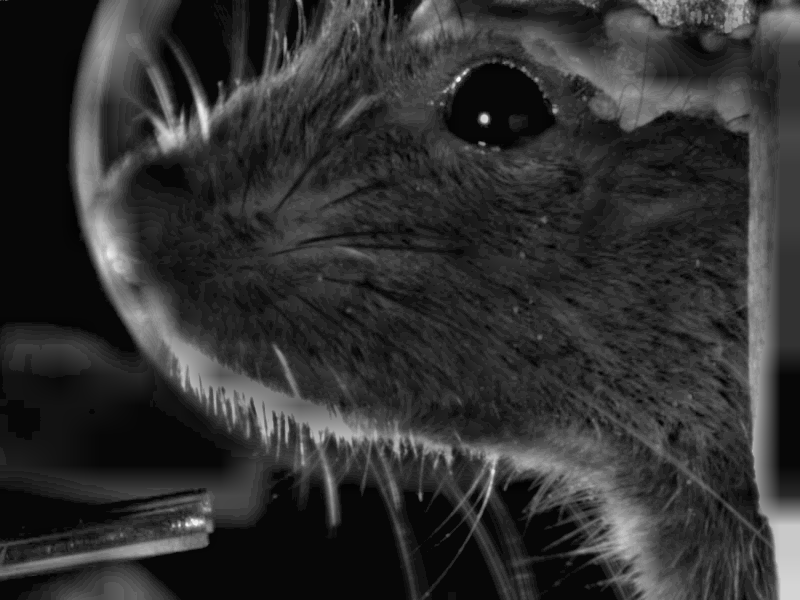

In [31]:
fr.visualization.display_toggle_image_stack([im_aug_template] + ims_aug)

In [32]:
aligner = fr.rois.Image_Aligner(verbose=True)

aligner.fit_geometric(
    template=im_aug_template,  ## template image
    ims_moving=ims_aug,  ## images to align
    template_method='image',  ## 'sequential': align images to neighboring images (good for drifting data). 'image': align to a single image
    mode_transform='euclidean',  ## type of geometric transformation. See openCV's cv2.findTransformECC for details
    mask_borders=(0,150,150,50),  ## number of pixels to mask off the edges (top, bottom, left, right)
    n_iter=50,  ## number of iterations for optimization
    termination_eps=1e-09,  ## convergence tolerance
    gaussFiltSize=41,  ## size of gaussian blurring filter applied to all images
    auto_fix_gaussFilt_step=10,  ## increment in gaussFiltSize after a failed optimization
)

aligner.transform_images_geometric(ims_aug);

im_template_geo = aligner.transform_images(
    ims_moving=[im_aug_template],
    remappingIdx=aligner.remappingIdx_geo,
)[0]

Finding geometric registration warps with mode: euclidean, template_method: image, mask_borders: True


Finding geometric registration warps: 100%|██████████| 13/13 [00:03<00:00,  4.01it/s]

Composing geometric warp matrices...
Applying geometric registration warps to images...


In [33]:
aligner.fit_nonrigid(
    template=im_template_geo,  ## template image
#     template=int(0),  ## specifies which image to use as the template. Either array (image), integer (ims_moving index), or float (ims_moving fractional index)
    ims_moving=aligner.ims_registered_geo,  ## Input images. Typically the geometrically registered images
    remappingIdx_init=aligner.remappingIdx_geo,  ## The remappingIdx between the original images (and ROIs) and ims_moving
    template_method='image',  ## 'sequential': align images to neighboring images. 'image': align to a single image, good if using geometric registration first
    mode_transform='createOptFlow_DeepFlow',  ## algorithm for non-rigid transformation. Either 'createOptFlow_DeepFlow' or 'calcOpticalFlowFarneback'. See openCV docs for each. 
    kwargs_mode_transform=None,  ## kwargs for `mode_transform`
)

aligner.transform_images_nonrigid(list(images.values()));

Finding nonrigid registration warps with mode: createOptFlow_DeepFlow, template_method: image


Finding nonrigid registration warps: 100%|██████████| 13/13 [00:08<00:00,  1.55image/s]


Composing nonrigid warp matrices...
Applying nonrigid registration warps to images...



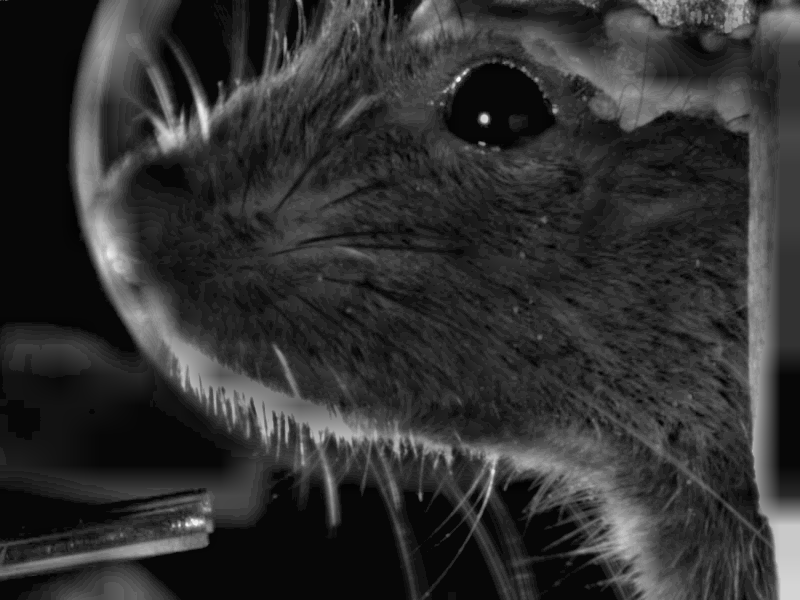


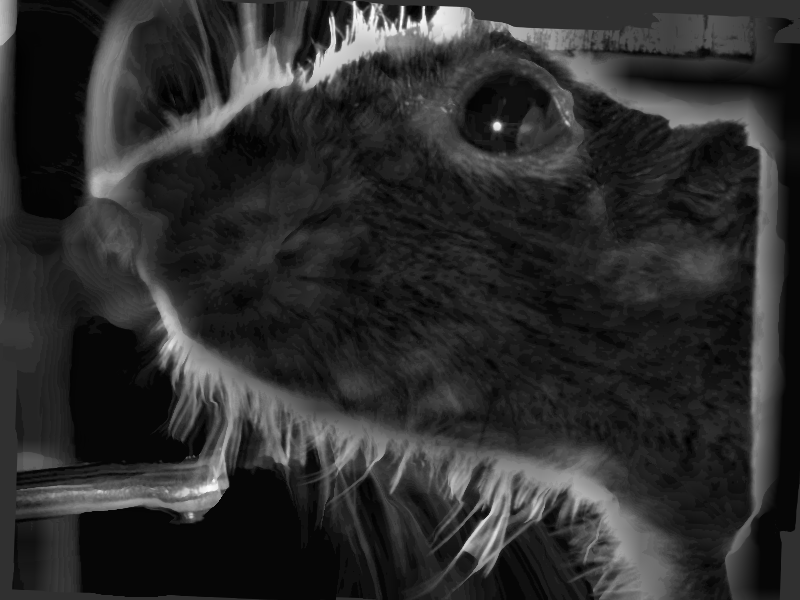

In [34]:
fr.visualization.display_toggle_image_stack([im_aug_template] + aligner.ims_registered_geo)

fr.visualization.display_toggle_image_stack(aligner.ims_registered_nonrigid)

In [86]:
remappingIdx = copy.deepcopy(aligner.remappingIdx_geo)

points_roiBorders_transformed = [{key: aligner.transform_points(
    points=points,
    remappingIdx=rmap_idx,
) for key, points in rois.roi_points.items()} for rmap_idx in remappingIdx]

points_forTracking_transformed = [aligner.transform_points(
    points=rois.point_positions,
    remappingIdx=rmap_idx,
) for rmap_idx in remappingIdx]

# exampleImages = list(images.values())
exampleImages = [np.tile((e * (0.1)).astype(np.uint8)[..., None], (1, 1, 3)) for e in images.values()]

In [87]:
rois_objs_new = {name: fr.rois.ROIs(
    select_mode='custom', 
    coords_rois=borderPoints, 
    exampleImage=exampleImage, 
    point_positions=point_positions
) for name, borderPoints, exampleImage, point_positions in tqdm(zip(paths_videos, points_roiBorders_transformed, exampleImages, points_forTracking_transformed))}

13it [00:01,  8.25it/s]


## 6. Save
Save the new `ROIs` objects. These can be used to initialize the `ROIs` objects in each face-rhythm run.

In [88]:
# names_sessions = ['__'.join(Path(name).parts[-6:-4]) for name in rois_objs_new.keys()]

for ii, (name, rois_new) in enumerate(rois_objs_new.items()):
    path_save = str(Path(directory_save) / names_sessions[ii] / f'ROIs.h5')
#     path_save = str(Path(directory_save) / f'ROIs.h5')
    rois_new.save_run_data(
        path_run_data=path_save,
        overwrite=True,
        verbose=1,
    )

FR WARNING: path_run_data file is expected to be named 'ROIs.h5' if it is part of a project. Please make sure this is correct.
FR Warning: Overwriting file. File: /Users/richardhakim/Documents/data/aligned_dots/20250225/ROIs.h5 already exists.
FR WARNING: path_run_data file is expected to be named 'ROIs.h5' if it is part of a project. Please make sure this is correct.
FR Warning: Overwriting file. File: /Users/richardhakim/Documents/data/aligned_dots/20250227/ROIs.h5 already exists.
FR WARNING: path_run_data file is expected to be named 'ROIs.h5' if it is part of a project. Please make sure this is correct.
FR Warning: Overwriting file. File: /Users/richardhakim/Documents/data/aligned_dots/20250228/ROIs.h5 already exists.
FR WARNING: path_run_data file is expected to be named 'ROIs.h5' if it is part of a project. Please make sure this is correct.
FR Warning: Overwriting file. File: /Users/richardhakim/Documents/data/aligned_dots/20250301/ROIs.h5 already exists.
FR WARNING: path_run_dat

## 7. Visualize!


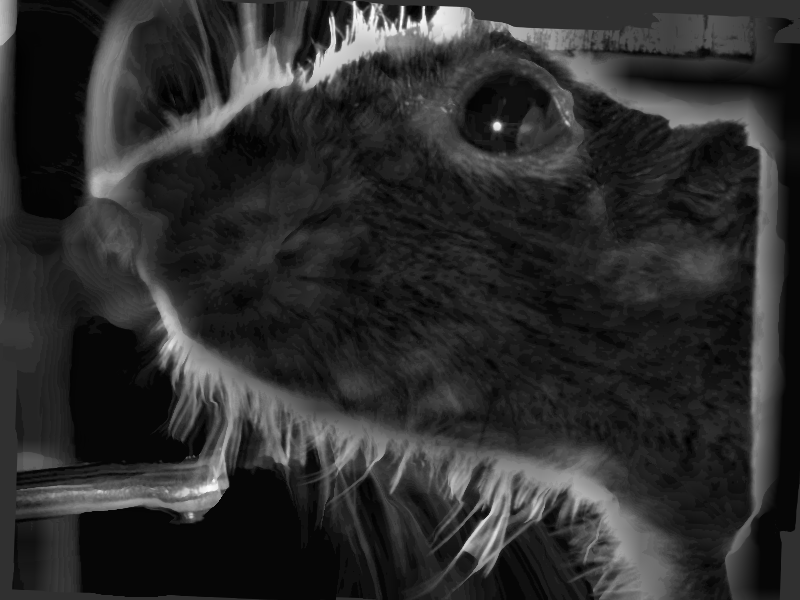

In [89]:
fr.visualization.display_toggle_image_stack(aligner.ims_registered_nonrigid)

In [ ]:
## Cast to uint8
movie = [np.tile((im * 0.15).astype(np.uint8)[:,:,None], (1,1,3)) for im in aligner.ims_registered_nonrigid]
## Add text overlay
movie = fr.helpers.add_text_to_images(movie, [[str(n)] for n in np.arange(len(movie))], position=(50,100), font_size=4, line_width=5,)

image_saver = fr.util.Image_Saver(
    dir_save=directory_save,
    overwrite=True,
)

image_saver.save_gif(
    array_images=movie, 
    name_save='mouse_face_matched', 
    frame_rate=10.0, 
    loop=0, 
)

In [91]:
frame_visualizer = fr.visualization.FrameVisualizer(
    display=False,
    frame_height_width=rois_objs_new[list(rois_objs_new.keys())[0]].img_hw,
    point_sizes=3,
    points_colors=(255,0,0),
    alpha=0.5,
)

images_with_warped_points = [frame_visualizer.visualize_image_with_points(
    image=rois.exampleImage,
    points=rois.point_positions,
) for rois in rois_objs_new.values()]


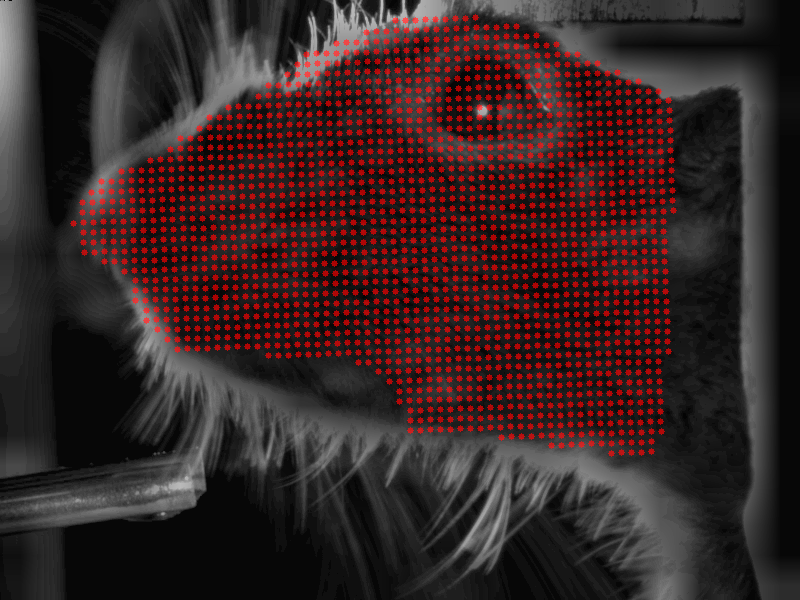

In [92]:
fr.visualization.display_toggle_image_stack(images_with_warped_points)

In [93]:
## Cast to uint8
movie = [im.astype(np.uint8) for im in images_with_warped_points]
## Add text overlay
movie = fr.helpers.add_text_to_images(movie, [[str(n)] for n in np.arange(len(movie))], position=(50,100), font_size=4, line_width=5,)

image_saver = fr.util.Image_Saver(
    dir_save=directory_save,
    overwrite=True,
)

image_saver.save_gif(
    array_images=movie, 
    name_save='mouse_face_points_matched', 
    frame_rate=3.0, 
    loop=0, 
)